<a href="https://colab.research.google.com/github/AfraHussaindeen/Pump-it-up/blob/main/pump_it_up.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Initial setup

## Install packages

In [ ]:
# Install relevant packages 
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 
! pip install xgboost

## Read data

In [ ]:
# Mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Import the required libraries 
import pandas as pd
import numpy as np
import os

# Define the paths to the dataset
DATASET_DIR = "/content/drive/MyDrive/Colab Notebooks/Pump it Up/Data"
train_features_path = os.path.join(DATASET_DIR,'trainFeatures.csv')
train_labels_path = os.path.join(DATASET_DIR,'trainLabels.csv')
test_features_path = os.path.join(DATASET_DIR , 'testFeatures.csv')

# Read the train and test dataset

train_features = pd.read_csv(train_features_path)
train_labels = pd.read_csv(train_labels_path)

train = train_features.copy()
train['status_group'] = train_labels['status_group']
test = pd.read_csv(test_features_path)

# Data visualization (Raw Data)

**Features**


* amount_tsh - Total static head (amount water available to waterpoint)
* date_recorded - The date the row was entered
* funder - Who funded the well
* gps_height - Altitude of the well
* installer - Organization that installed the well
* longitude - GPS coordinate
* latitude - GPS coordinate
* wpt_name - Name of the waterpoint if there is one
* num_private -
* basin - Geographic water basin
* subvillage - Geographic location
* region - Geographic location
* region_code - Geographic location (coded)
* district_code - Geographic location (coded)
* lga - Geographic location
* ward - Geographic location
* population - Population around the well
* public_meeting - True/False
* recorded_by - Group entering this row of data
* scheme_management - Who operates the waterpoint
* scheme_name - Who operates the waterpoint
* permit - If the waterpoint is permitted
* construction_year - Year the waterpoint was constructed
* extraction_type - The kind of extraction the waterpoint uses
* extraction_type_group - The kind of extraction the waterpoint uses
* extraction_type_class - The kind of extraction the waterpoint uses
* management - How the waterpoint is managed
* management_group - How the waterpoint is managed
* payment - What the water costs
* payment_type - What the water costs
* water_quality - The quality of the water
* quality_group - The quality of the water
* quantity - The quantity of water
* quantity_group - The quantity of water
* source - The source of the water
* source_type - The source of the water
* source_class - The source of the water
* waterpoint_type - The kind of waterpoint
* waterpoint_type_group - The kind of waterpoint

In [ ]:
# import required libraries
from pandas_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
# create profiles for both train and test data seperately
prof_train = ProfileReport(train , title = 'Train dataset', html={'style' : {'full_width':True}}) 
prof_test = ProfileReport(test , title = 'Test dataset', html={'style' : {'full_width':True}}) 

In [ ]:
# visualize the profile for the train dataset (including the label)
prof_train.to_notebook_iframe()

Summarize dataset:   0%|          | 0/54 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# visualize the profile for the test dataset 
prof_test.to_notebook_iframe()

Summarize dataset:   0%|          | 0/53 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#Preprocessing

## Data cleaning

In [ ]:
drop_columns = ['scheme_name' , 'amount_tsh' , 'wpt_name' , 'num_private' , 'recorded_by'] 
# 47% of scheme_name are missing
# 'amount_tsh', 'num_private' has plenty of zeros
# 'wpt_name' has a high cardinality
# 'recorded_by' constant value

# Drop columns in the train dataset
train = train.drop(( drop_columns+ ['id']),axis=1)
# Drop columns in the test dataset
test = test.drop(drop_columns ,axis=1)



In [ ]:
# (gps_height) Having longitude = 0 is not possible. This let's set the 0 values to nan
train.loc[train.gps_height == 0, 'gps_height'] = np.nan
test.loc[test.gps_height == 0, 'gps_height'] = np.nan

# (gps_height) Impute the missing coordinates with the average longitude based on subvillage 
train.gps_height.fillna(train.groupby(['subvillage'])['gps_height'].transform('mean'), inplace=True)
test.gps_height.fillna(test.groupby(['subvillage'])['gps_height'].transform('mean'), inplace=True)

# (gps_height) To remove the remaining nans impute them based on ward 
train.gps_height.fillna(train.groupby(['ward'])['gps_height'].transform('mean'), inplace=True)
test.gps_height.fillna(test.groupby(['ward'])['gps_height'].transform('mean'), inplace=True)

# (gps_height) To remove the remaining nans impute them based on lga 
train.gps_height.fillna(train.groupby(['lga'])['gps_height'].transform('mean'), inplace=True)
test.gps_height.fillna(test.groupby(['lga'])['gps_height'].transform('mean'), inplace=True)

# (gps_height) To remove the remaining nans impute them based on region_code
train.gps_height.fillna(train.groupby(['region_code'])['gps_height'].transform('mean'), inplace=True)
test.gps_height.fillna(test.groupby(['region_code'])['gps_height'].transform('mean'), inplace=True)

#.......................

# (subvillage) Impute the nans to Unknown
train.subvillage.fillna(value='other', inplace=True)
test.subvillage.fillna(value='other', inplace=True)

# (subvillage) Remove the clear errors ( One letter names )
train.loc[train.subvillage.str.len() == 1, 'subvillage'] = 'other'
test.loc[test.subvillage.str.len() == 1, 'subvillage'] = 'other'

#........................

# (funder) Impute the nans to Unknown
train.funder.fillna(value='other', inplace=True)
test.funder.fillna(value='other', inplace=True)

# (funder) Remove the clear errors ( One letter names)
train.loc[train.funder.str.len() == 1, 'funder'] = 'other'
test.loc[test.funder.str.len() == 1, 'funder'] = 'other'

#........................

# (longitude) Having longitude = 0 is not possible. This let's set the 0 values to nan
train.loc[train.longitude == 0, 'longitude'] = np.nan
test.loc[test.longitude == 0, 'longitude'] = np.nan

# (longitude) Impute the missing coordinates with the average longitude based on subvillage 
train.longitude.fillna(train.groupby(['subvillage'])['longitude'].transform('mean'), inplace=True)
test.longitude.fillna(test.groupby(['subvillage'])['longitude'].transform('mean'), inplace=True)

# (longitude) To remove the remaining nans impute them based on ward 
train.longitude.fillna(train.groupby(['ward'])['longitude'].transform('mean'), inplace=True)
test.longitude.fillna(test.groupby(['ward'])['longitude'].transform('mean'), inplace=True)

# (longitude) To remove the remaining nans impute them based on lga 
train.longitude.fillna(train.groupby(['lga'])['longitude'].transform('mean'), inplace=True)
test.longitude.fillna(test.groupby(['lga'])['longitude'].transform('mean'), inplace=True)

#........................

# (latitude) Having longitude = 0 is not possible. This let's set the 0 values to nan
train.loc[train.latitude == 0, 'latitude'] = np.nan
test.loc[test.latitude == 0, 'latitude'] = np.nan

# (latitude) Impute the missing coordinates with the average longitude based on subvillage 
train.latitude.fillna(train.groupby(['subvillage'])['latitude'].transform('mean'), inplace=True)
test.latitude.fillna(test.groupby(['subvillage'])['latitude'].transform('mean'), inplace=True)

# (latitude) To remove the remaining nans impute them based on ward 
train.latitude.fillna(train.groupby(['ward'])['latitude'].transform('mean'), inplace=True)
test.latitude.fillna(test.groupby(['ward'])['latitude'].transform('mean'), inplace=True)

# (latitude) To remove the remaining nans impute them based on lga 
train.latitude.fillna(train.groupby(['lga'])['latitude'].transform('mean'), inplace=True)
test.latitude.fillna(test.groupby(['lga'])['latitude'].transform('mean'), inplace=True)

#........................

# (installer) Impute the nans to Unknown
train.installer.fillna(value='other', inplace=True)
test.installer.fillna(value='other', inplace=True)

# (installer) Remove the clear errors ( One letter names)
train.loc[train.installer.str.len() == 1, 'installer'] = 'other'
test.loc[test.installer.str.len() == 1, 'installer'] = 'other'

#........................

# (population) Having population = 0 is not possible. let's set the 0 values to nan 
train.loc[train.population == 0, 'population'] = np.nan
test.loc[test.population == 0, 'population'] = np.nan

# (population) Impute the missing values with the median population based on subvillage 
train.population.fillna(train.groupby(['subvillage'])['population'].transform('median'), inplace=True)
test.population.fillna(test.groupby(['subvillage'])['population'].transform('median'), inplace=True)

# (population) To remove the remaining nans impute them based on ward 
train.population.fillna(train.groupby(['ward'])['population'].transform('median'), inplace=True)
test.population.fillna(test.groupby(['ward'])['population'].transform('median'), inplace=True)

# (population) To remove the remaining nans impute them based on lga 
train.population.fillna(train.groupby(['lga'])['population'].transform('median'), inplace=True)
test.population.fillna(test.groupby(['lga'])['population'].transform('median'), inplace=True)

# (population) To remove the remaining nans impute them based on region_code
train.population.fillna(train.groupby(['region_code'])['population'].transform('median'), inplace=True)
test.population.fillna(test.groupby(['region_code'])['population'].transform('median'), inplace=True)

#.........................

# (public_meeting) Since 85.9% are true. let's impute nans with True
train.public_meeting.fillna(True, inplace=True)
test.public_meeting.fillna(True, inplace=True)

# (public_meeting) Set True=1 & False=0
train.loc[train.public_meeting == True, 'public_meeting'] = 1
train.loc[train.public_meeting == False, 'public_meeting'] = 0
test.loc[test.public_meeting == True, 'public_meeting'] = 1
test.loc[test.public_meeting == False, 'public_meeting'] = 0

#.........................

# (scheme_management) Impute the nans to Unknown
train.scheme_management.fillna(value='other', inplace=True)
test.scheme_management.fillna(value='other', inplace=True)

#........................

# (construction_year) Having construction_year = 0 is not possible. let's set the 0 values to nan 
train.loc[train.construction_year == 0, 'construction_year'] = np.nan
test.loc[test.construction_year == 0, 'construction_year'] = np.nan

# (construction_year) Impute the missing values with the median construction_year based on subvillage 
train.construction_year.fillna(train.groupby(['subvillage'])['construction_year'].transform('median'), inplace=True)
test.construction_year.fillna(test.groupby(['subvillage'])['construction_year'].transform('median'), inplace=True)

# (construction_year) To remove the remaining nans impute them based on ward 
train.construction_year.fillna(train.groupby(['ward'])['construction_year'].transform('median'), inplace=True)
test.construction_year.fillna(test.groupby(['ward'])['construction_year'].transform('median'), inplace=True)

# (construction_year) To remove the remaining nans impute them based on lga 
train.construction_year.fillna(train.groupby(['lga'])['construction_year'].transform('median'), inplace=True)
test.construction_year.fillna(test.groupby(['lga'])['construction_year'].transform('median'), inplace=True)

# (construction_year) To remove the remaining nans impute them based on region_code
train.construction_year.fillna(train.groupby(['region_code'])['construction_year'].transform('median'), inplace=True)
test.construction_year.fillna(test.groupby(['region_code'])['construction_year'].transform('median'), inplace=True)

# (construction_year) Remove decimals
train.construction_year = train.construction_year.round(0)
test.construction_year = test.construction_year.round(0)

#........................

# (permit) To remove the remaining nans impute them based on region_code
train['permit'] = train.groupby(['region_code'])['permit'].apply(lambda x: x.fillna(x.mode().iloc[0]))
test['permit'] = test.groupby(['region_code'])['permit'].apply(lambda x: x.fillna(x.mode().iloc[0]))

In [ ]:
train.isnull().sum()

date_recorded            0
funder                   0
gps_height               0
installer                0
longitude                0
latitude                 0
basin                    0
subvillage               0
region                   0
region_code              0
district_code            0
lga                      0
ward                     0
population               0
public_meeting           0
scheme_management        0
permit                   0
construction_year        0
extraction_type          0
extraction_type_group    0
extraction_type_class    0
management               0
management_group         0
payment                  0
payment_type             0
water_quality            0
quality_group            0
quantity                 0
quantity_group           0
source                   0
source_type              0
source_class             0
waterpoint_type          0
waterpoint_type_group    0
status_group             0
dtype: int64

##Feature Engineering

In [ ]:
# (district_code) Check the uniqueness 
train.groupby(['region_code','district_code']).size()[:15]

region_code  district_code
1            0                  23
             1                 888
             3                 361
             4                 347
             5                 358
             6                 224
2            1                 189
             2                1206
             3                 109
             5                 201
             6                 310
             7                1009
3            1                 595
             2                 519
             3                 877
dtype: int64

In [ ]:
train.region_code.unique()

array([11, 20, 21, 90, 18,  4, 17, 14, 60, 10,  3, 15, 19, 16, 80,  1,  6,
        2, 12, 13,  5,  7, 99, 24,  9,  8, 40])

In [ ]:
train.district_code.unique()

array([ 5,  2,  4, 63,  1,  8,  3,  6, 43,  7, 23, 33, 53, 62, 60, 30, 13,
        0, 80, 67])

In [ ]:
# 'district_code' gets repeated. Hence standalone value might not give a uniqueness.
# Therefore create 'region_code'+'district_code'

train['unique_district_code'] = train['region_code']*100 + train['district_code']
test['unique_district_code'] = test['region_code']*100 + test['district_code']

In [ ]:
# (date_recorded)
train.date_recorded[:15]

0     2011-03-14
1     2013-03-06
2     2013-02-25
3     2013-01-28
4     2011-07-13
5     2011-03-13
6     2012-10-01
7     2012-10-09
8     2012-11-03
9     2011-08-03
10    2011-02-20
11    2013-02-18
12    2012-10-14
13    2013-03-15
14    2012-10-20
Name: date_recorded, dtype: object

In [ ]:
# (date_recorded) Has a format of '2011-03-14'.Extract year and month informations
train['year_recorded'] = train.date_recorded.str.slice(0,4).astype('int', errors='ignore')
train['month_recorded'] = train.date_recorded.str.slice(5,7).astype('int', errors='ignore')
test['year_recorded'] = test.date_recorded.str.slice(0,4).astype('int', errors='ignore')
test['month_recorded'] = test.date_recorded.str.slice(5,7).astype('int', errors='ignore')


In [ ]:
train['month_recorded'].unique()

array([ 3,  2,  1,  7, 10, 11,  8,  9,  4,  5,  6, 12])

In [ ]:
train['year_recorded'].value_counts()

2011    28674
2013    24271
2012     6424
2004       30
2002        1
Name: year_recorded, dtype: int64

In [ ]:
test['year_recorded'].value_counts()

2011    7234
2013    5939
2012    1665
2004      11
2001       1
Name: year_recorded, dtype: int64

In [ ]:
# (year_recorded) The years 2001, 2002, 2004 seems to be an error caused during data entry.
# Hence replace them with 2011, 2012 and 2014
train.loc[train.year_recorded == 2001, 'year_recorded'] = 2011
train.loc[train.year_recorded == 2002, 'year_recorded'] = 2012
train.loc[train.year_recorded == 2004, 'year_recorded'] = 2014

test.loc[test.year_recorded == 2001, 'year_recorded'] = 2011
test.loc[test.year_recorded == 2002, 'year_recorded'] = 2012
test.loc[test.year_recorded == 2004, 'year_recorded'] = 2014

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


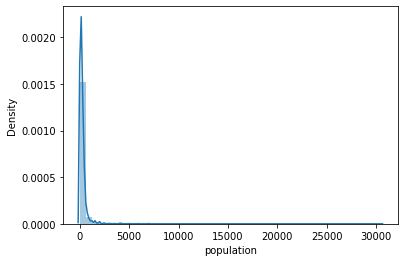

In [ ]:
# (population) Check the distribution
sns.distplot(train.population)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


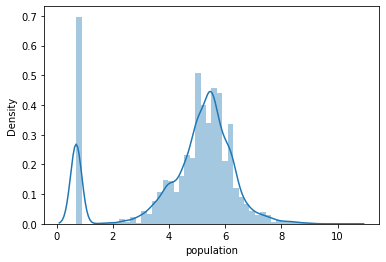

In [ ]:
# (population) Check the distribution of population with log transformations
sns.distplot(np.log1p(train.population))

In [ ]:
# Effect of skewness : https://towardsdatascience.com/skewed-data-a-problem-to-your-statistical-model-9a6b5bb74e37
# (population) Remove the skewness in the 'population' 
train['population_log'] = np.log1p(train['population'])
test['population_log'] = np.log1p(test['population'])

In [ ]:
# (year_recorded , construction_year) Create age column 
train['age'] = (train.year_recorded - train.construction_year).astype('int', errors='ignore')
test['age'] = (test.year_recorded - test.construction_year).astype('int', errors='ignore')

In [ ]:
train['age'].unique()

array([12,  3,  4, 27, 14,  2,  5, 13,  7,  0, 26, 24, 15, 20, 33, 19, 16,
       39, 11, 41, 21,  8, 25,  9, 38, 28, 43,  1, 22, 10, 23,  6, 35, 49,
       17, 32, 37, 36, 30, 51, 29, 40, 53, -1, 50, 31, 18, 42, -2, 45, 34,
       46, 48, 44, 47, 52])

In [ ]:
# (age) Remove the negative values
train.loc[train.age < 0, 'age'] = 1
test.loc[test.age < 0, 'age'] = 1

In [ ]:
# (month_recorded) Create 'season' column

# Jan and Feb short dry season
# long rains lasts during about March, April and May 
# long dry season lasts throughout June, July, August, September and October 
# During November and December there's another rainy season: the 'short rains'

train.loc[(train.month_recorded <= 2) & (train.month_recorded >= 1), 'season'] = 1
train.loc[(train.month_recorded <= 5) & (train.month_recorded >= 3), 'season'] = 2
train.loc[(train.month_recorded <= 10) & (train.month_recorded >= 6), 'season'] = 3
train.loc[(train.month_recorded <= 12) & (train.month_recorded >= 11), 'season'] = 4

test.loc[(test.month_recorded <= 2) & (test.month_recorded >= 1), 'season'] = 1
test.loc[(test.month_recorded <= 5) & (test.month_recorded >= 3), 'season'] = 2
test.loc[(test.month_recorded <= 10) & (test.month_recorded >= 6), 'season'] = 3
test.loc[(test.month_recorded <= 12) & (test.month_recorded >= 11), 'season'] = 4

##Remove duplicate features

In [ ]:
# (extraction_type_class) Check the unique values
train.extraction_type_class.unique()

array(['gravity', 'submersible', 'handpump', 'other', 'motorpump',
       'wind-powered', 'rope pump'], dtype=object)

In [ ]:
# (extraction_type) Check the unique values
train.extraction_type.unique()

array(['gravity', 'submersible', 'swn 80', 'nira/tanira', 'india mark ii',
       'other', 'ksb', 'mono', 'windmill', 'afridev', 'other - rope pump',
       'india mark iii', 'other - swn 81', 'other - play pump', 'cemo',
       'climax', 'walimi', 'other - mkulima/shinyanga'], dtype=object)

In [ ]:
# (extraction_type_group) Check the unique values
train.extraction_type_group.unique()

array(['gravity', 'submersible', 'swn 80', 'nira/tanira', 'india mark ii',
       'other', 'mono', 'wind-powered', 'afridev', 'rope pump',
       'india mark iii', 'other handpump', 'other motorpump'],
      dtype=object)

In [ ]:
# (payment , payment_type) Check the similarity
train.groupby(['payment','payment_type']).size()

payment                payment_type
never pay              never pay       25348
other                  other            1054
pay annually           annually         3642
pay monthly            monthly          8300
pay per bucket         per bucket       8985
pay when scheme fails  on failure       3914
unknown                unknown          8157
dtype: int64

In [ ]:
# (payment , payment_type) Check the similarity
train.groupby(['water_quality' , 'quality_group']).size()

water_quality       quality_group
coloured            colored            490
fluoride            fluoride           200
fluoride abandoned  fluoride            17
milky               milky              804
salty               salty             4856
salty abandoned     salty              339
soft                good             50818
unknown             unknown           1876
dtype: int64

In [ ]:
# (quantity , quantity_group) Check the similarity
train.groupby(['quantity','quantity_group']).size()

quantity      quantity_group
dry           dry                6246
enough        enough            33186
insufficient  insufficient      15129
seasonal      seasonal           4050
unknown       unknown             789
dtype: int64

In [ ]:
# (source_type  , source) Check the similarity
train.groupby(['source_type','source']).size()


source_type           source              
borehole              hand dtw                  874
                      machine dbh             11075
dam                   dam                       656
other                 other                     212
                      unknown                    66
rainwater harvesting  rainwater harvesting     2295
river/lake            lake                      765
                      river                    9612
shallow well          shallow well            16824
spring                spring                  17021
dtype: int64

In [ ]:
# (waterpoint_type , waterpoint_type_group ) Check the similarity
train.groupby(['waterpoint_type_group', 'waterpoint_type']).size()


waterpoint_type_group  waterpoint_type            
cattle trough          cattle trough                    116
communal standpipe     communal standpipe             28522
                       communal standpipe multiple     6103
dam                    dam                                7
hand pump              hand pump                      17488
improved spring        improved spring                  784
other                  other                           6380
dtype: int64

In [ ]:
# (management , management_group) Check the similarity
train.groupby(['management_group', 'management']).size()

management_group  management      
commercial        company               685
                  private operator     1971
                  trust                  78
                  water authority       904
other             other                 844
                  other - school         99
parastatal        parastatal           1768
unknown           unknown               561
user-group        vwc                 40507
                  water board          2933
                  wua                  2535
                  wug                  6515
dtype: int64

In [ ]:
drop_duplicate_cols = ['region' , 'payment' , 'quality_group' , 'quantity' , 'source' , "waterpoint_type", 'district_code' ,'extraction_type' , 'extraction_type_group' ]
# 'region' & 'region_code' gives the same info with 'region_code' having a greater info
# 'payment' & 'payment_type' gives the same info
# 'water_quality'& 'quality_group' gives the same info with 'water_quality' having a greater info
# 'quantity'&'quantity_group' gives the same info
# 'source_type' & 'source' gives the same info
# 'waterpoint_type_group' & 'waterpoint_type' gives the same info
# 'district_code' contains duplicate values where different regions have the same 'district_code'
# 'extraction_type_class' contains a well defined set of classes while 'extraction_type'
# and 'extraction_type_group' contains main classes + sub classess

drop_encoded_cols = ['date_recorded' , 'population']

drop_high_cardinality_cols = ['funder' , 'installer' , 'subvillage' , 'lga' , 'ward' ]

In [ ]:
# Drop the unwanted columns
train = train.drop(drop_duplicate_cols + drop_encoded_cols + drop_high_cardinality_cols , axis=1)
test = test.drop(drop_duplicate_cols + drop_encoded_cols + drop_high_cardinality_cols, axis=1)

In [ ]:
train.columns

Index(['gps_height', 'longitude', 'latitude', 'basin', 'region_code',
       'public_meeting', 'scheme_management', 'permit', 'construction_year',
       'extraction_type_class', 'management', 'management_group',
       'payment_type', 'water_quality', 'quantity_group', 'source_type',
       'source_class', 'waterpoint_type_group', 'status_group',
       'unique_district_code', 'year_recorded', 'month_recorded',
       'population_log', 'age', 'season'],
      dtype='object')

###Visualize data correlation with the label

In [ ]:
# Define the numerical and categorical columns in the dataset 
label_col ='status_group' 
categorical_cols = list (train.select_dtypes(exclude="number").columns)
categorical_cols.remove(label_col)
numerical_cols = list (train.select_dtypes(include="number").columns)

In [ ]:
categorical_cols

['basin',
 'public_meeting',
 'scheme_management',
 'permit',
 'extraction_type_class',
 'management',
 'management_group',
 'payment_type',
 'water_quality',
 'quantity_group',
 'source_type',
 'source_class',
 'waterpoint_type_group']

In [ ]:
numerical_cols

['gps_height',
 'longitude',
 'latitude',
 'region_code',
 'construction_year',
 'unique_district_code',
 'year_recorded',
 'month_recorded',
 'population_log',
 'age',
 'season']

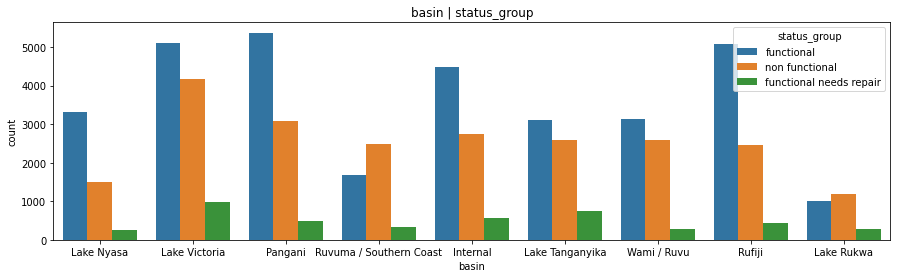

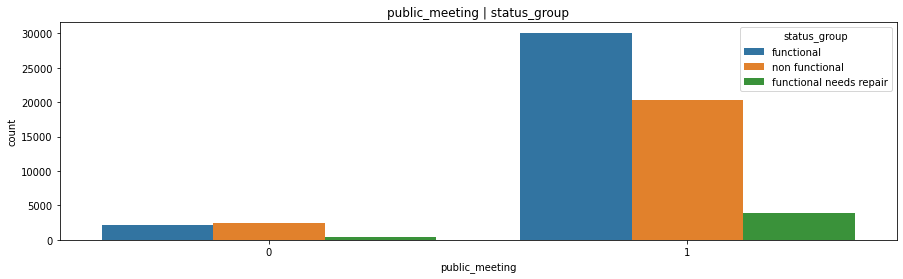

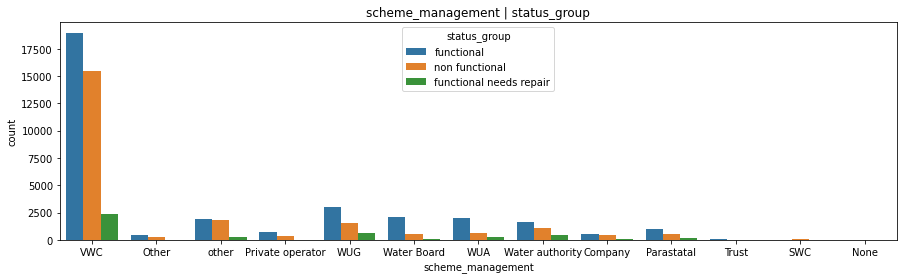

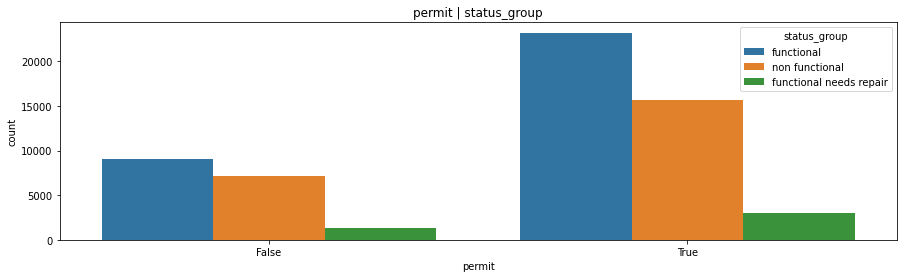

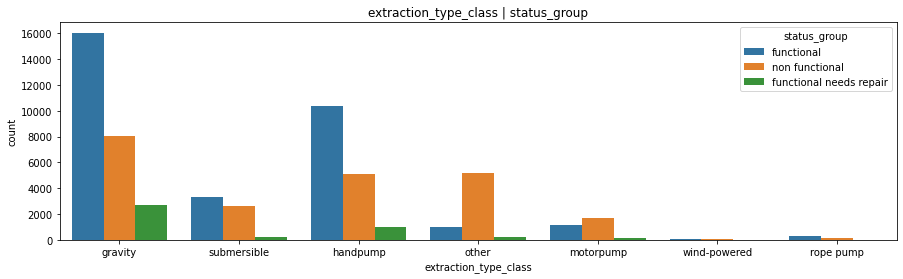

...

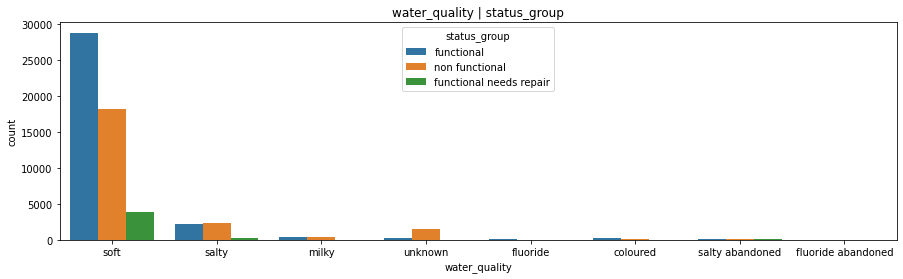

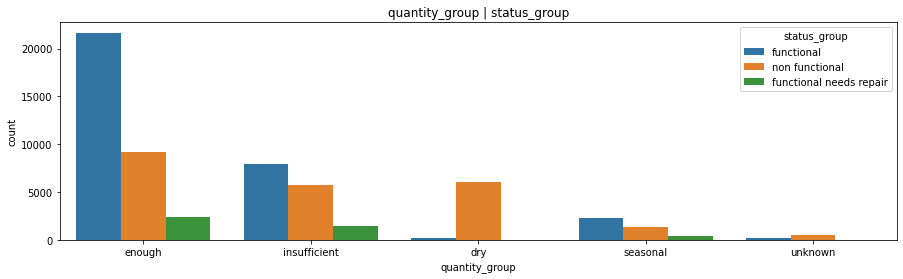

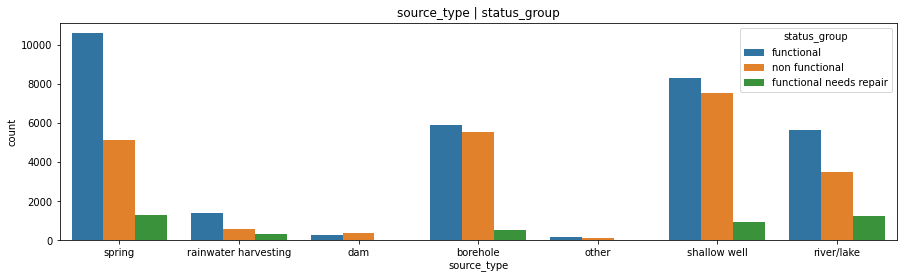

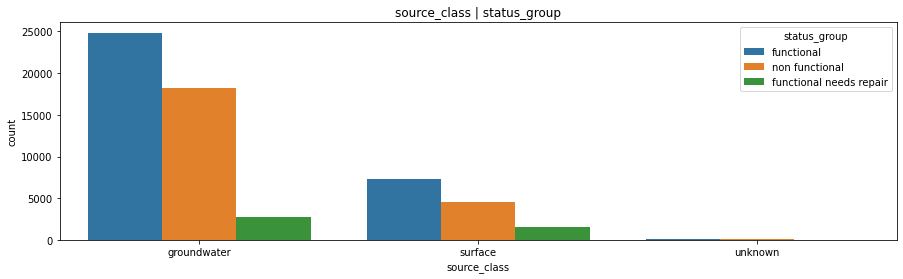

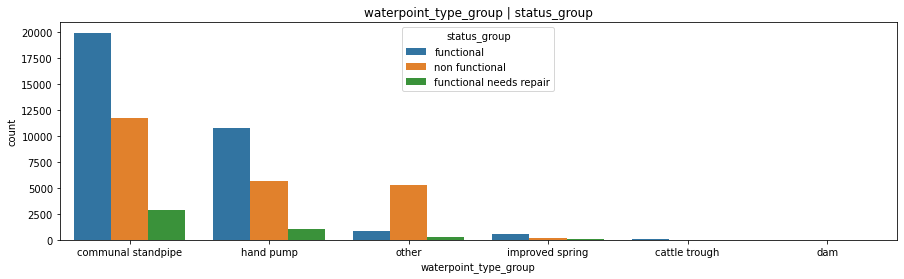

In [ ]:
# Visualize the correlation of categorical features with 
for col in (categorical_cols) :

  fig = plt.figure(figsize = (15,4) )

  plt.title(col+ ' | '+'status_group')
  sns.countplot(x=col , hue='status_group' , data=train)
  plt.show()
  

##Feature Encoding

In [ ]:
# Encode the features in the train and test dataset
train_encoded = pd.get_dummies(train[categorical_cols+numerical_cols])
test_encoded = pd.get_dummies(test)

test_encoded = test_encoded.reindex(columns = train_encoded.columns, fill_value=0)

In [ ]:
# Encode the permit feature manually
train_encoded.replace({'permit': {True: 1, False:0}}, inplace=True)
test_encoded.replace({'permit': {True: 1, False:0}}, inplace=True)

In [ ]:
# Encode the label in the train dataset
def encode_label (x):
  labels_dict = {'functional':0,'non functional':1, 'functional needs repair':2}
  return labels_dict[x]

# Define X,y and X_test
y = train[label_col].apply(encode_label)

##Feature Selection

In [ ]:
# Define the featuures to be selected 
# These features were selected by taking into account the feature importance gained 
# from the randomforest.

selected_features =['quantity_group_dry',
 'longitude',
 'latitude',
 'gps_height',
 'construction_year',
 'age',
 'population_log',
 'unique_district_code',
 'quantity_group_enough',
 'extraction_type_class_other',
 'waterpoint_type_group_other',
 'region_code',
 'month_recorded',
 'payment_type_never pay',
 'quantity_group_insufficient',
 'extraction_type_class_handpump',
 'season',
 'extraction_type_class_gravity',
 'waterpoint_type_group_communal standpipe',
 'permit',
 'source_type_shallow well',
 'waterpoint_type_group_hand pump',
 'payment_type_per bucket',
 'management_vwc',
 'quantity_group_seasonal',
 'year_recorded',
 'payment_type_unknown',
 'source_type_borehole',
 'source_type_spring',
 'payment_type_monthly',
 'water_quality_soft',
 'scheme_management_VWC',
 'source_class_surface',
 'water_quality_unknown',
 'extraction_type_class_submersible',
 'source_class_groundwater',
 'public_meeting_1',
 'basin_Internal',
 'public_meeting_0',
 'payment_type_annually',
 'source_type_river/lake',
 'basin_Lake Victoria',
 'basin_Lake Nyasa',
 'extraction_type_class_motorpump',
 'management_group_user-group',
 'basin_Rufiji',
 'basin_Lake Tanganyika',
 'source_type_rainwater harvesting',
 'water_quality_salty',
 'management_group_commercial',
 'scheme_management_WUG',
 'scheme_management_Water authority',
 'management_wug',
 'scheme_management_other',
 'basin_Pangani',
 'basin_Lake Rukwa',
 'payment_type_on failure',
 'basin_Wami / Ruvu',
 'scheme_management_Water Board',
 'management_water board',
 'basin_Ruvuma / Southern Coast',
 'quantity_group_unknown',
 'waterpoint_type_group_improved spring',
 'scheme_management_WUA',
 'management_private operator',
 'management_wua',
 'management_company',
 'scheme_management_Company',
 'source_type_dam',
 'scheme_management_Parastatal']

In [ ]:
# Create a copy of train and test dataset
X = train_encoded.copy()
X_test = test_encoded.copy()

# Then consider only the selcted features
X = X[selected_features]
X_test = X_test[selected_features]

##Feature Normalizing

In [ ]:
# Normalizing features
from sklearn.preprocessing import Normalizer

# Defining the normalized
normalizer = Normalizer()

# Fitting normalizer to train set
normalizer.fit(X)
X_norm = normalizer.transform(X)

X_test_norm = normalizer.transform(X_test)

#Dataset Splitting

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(
    X, y, stratify=y, test_size=0.33 , random_state=1452
)

#Model training & Evaluation

In [ ]:
from sklearn.metrics import accuracy_score

##Xgboost

In [ ]:
from xgboost import XGBClassifier

In [ ]:
# Define classifier
xgb = XGBClassifier( n_estimators=300)

# Fit the model
xgb.fit(X_train,y_train)

# make prediction on train datset
y_train_pred = xgb.predict(X_train)

# make predictions for val data
y_val_pred = xgb.predict(X_val)

# evaluate predictions
accuracy_train = accuracy_score(y_train, y_train_pred)
accuracy_val = accuracy_score(y_val, y_val_pred)

print("Train Accuracy: %.2f%%" % (accuracy_train * 100.0))
print("Validation Accuracy: %.2f%%" % (accuracy_val * 100.0))


Train Accuracy: 76.82%
Validation Accuracy: 76.09%


In [ ]:
# Variable importance

variable_importance = pd.concat([pd.DataFrame(X.columns), 
                                pd.DataFrame(xgb.feature_importances_)], 
                                    axis = 1)

variable_importance.columns = ['variable', 'importance']
variable_importance.sort_values(by='importance', ascending=False)[:20]

,variable,importance
0,quantity_group_dry,0.183137
10,waterpoint_type_group_other,0.139278
9,extraction_type_class_other,0.075765
13,payment_type_never pay,0.037587
8,quantity_group_enough,0.025185
35,source_class_groundwater,0.023752
23,management_vwc,0.021323
5,age,0.019035
17,extraction_type_class_gravity,0.018242
33,water_quality_unknown,0.017316


##RandomForest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
# Define classifier with parameters from grid search
forest = RandomForestClassifier(n_estimators=50, 
                                min_samples_split=8,
                                max_features='sqrt',
                                max_depth=70,
                                random_state=42)

# Fit the model
forest.fit(X_train,y_train)

# make prediction on train datset
y_train_pred = forest.predict(X_train)

# make predictions for val data
y_val_pred = forest.predict(X_val)

# evaluate predictions
accuracy_train = accuracy_score(y_train, y_train_pred)
accuracy_val = accuracy_score(y_val, y_val_pred)

print("Train Accuracy: %.2f%%" % (accuracy_train * 100.0))
print("Validation Accuracy: %.2f%%" % (accuracy_val * 100.0))

In [ ]:
# Variable importance

variable_importance = pd.concat([pd.DataFrame(X.columns), 
                                pd.DataFrame(forest.feature_importances_)], 
                                    axis = 1)

variable_importance.columns = ['variable', 'importance']
im = variable_importance.sort_values(by='importance', ascending=False)

Text(0, 0.5, 'FEATURE NAMES')

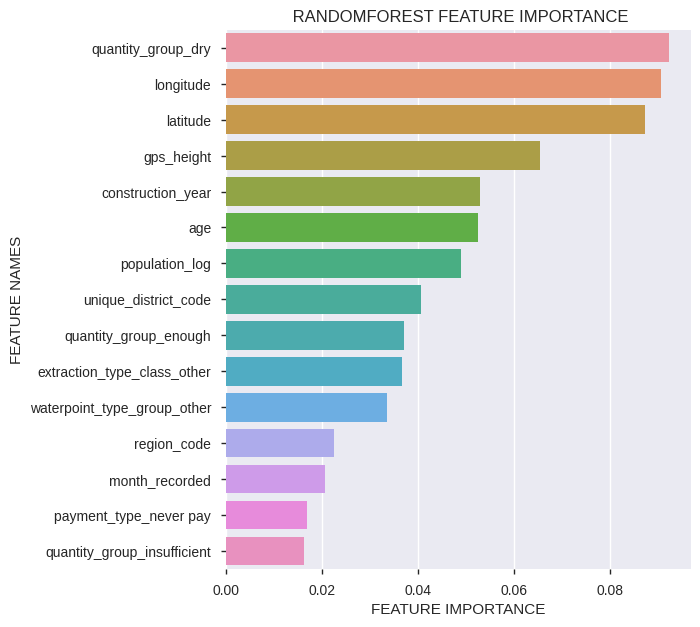

In [ ]:
# Define size of bar plot
plt.figure(figsize=(6,7))

# Viisualize the top 15 features
sns.barplot(x='importance', y='variable' , data = im[:15])

# Add chart labels
plt.title(' RANDOMFOREST FEATURE IMPORTANCE')
plt.xlabel('FEATURE IMPORTANCE')
plt.ylabel('FEATURE NAMES')

## Ensemble Model

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier
from matplotlib import pyplot

In [ ]:
# get a stacking ensemble of models
def get_stacking():
	# define the base models
	level0 = list()
	# level0.append(('ctb', CatBoostClassifier(learning_rate=0.001)))
	level0.append(('xgb', XGBClassifier( n_estimators=300)))
	level0.append(('rf', RandomForestClassifier(n_estimators=50, 
                                min_samples_split=8,
                                max_features='sqrt',
                                max_depth=70,
                                random_state=42)))
	# define meta learner model
	level1 = LogisticRegression()
	# define the stacking ensemble
	stack_model = StackingClassifier(estimators=level0, final_estimator=level1, cv=5)
	return stack_model

In [ ]:
# Define the stacking ensemble
stack_model = get_stacking()

# Fit the model
stack_model.fit(X_train,y_train)


StackingClassifier(cv=5,
                   estimators=[('xgb',
                                XGBClassifier(base_score=0.5, booster='gbtree',
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=1, gamma=0,
                                              learning_rate=0.1,
                                              max_delta_step=0, max_depth=3,
                                              min_child_weight=1, missing=None,
                                              n_estimators=300, n_jobs=1,
                                              nthread=None,
                                              objective='binary:logistic',
                                              random_state=0, reg_alpha=0,
                                              reg_lambda=1, scale_pos...
                                                       random_state=4

In [ ]:
# make prediction on train datset
y_train_pred = stack_model.predict(X_train)

# make predictions for val data
y_val_pred = stack_model.predict(X_val)

# evaluate predictions
accuracy_train = accuracy_score(y_train, y_train_pred)
accuracy_val = accuracy_score(y_val, y_val_pred)

print("Train Accuracy: %.2f%%" % (accuracy_train * 100.0))
print("Validation Accuracy: %.2f%%" % (accuracy_val * 100.0))

Train Accuracy: 89.81%
Validation Accuracy: 80.50%


#Model Evaluation on test dataset

In [ ]:
# XgBoost

# make prediction on train datset
y_test_pred = xgb.predict(X_test)

# Save the test output to a csv file
output = pd.DataFrame({'id': test.id, 'status_group': y_test_pred })

# Encode the label in the train dataset
def decode_label (x):
  labels_dict = {0:'functional',1:'non functional', 2:'functional needs repair'}
  return labels_dict[x]

output['status_group'] = output['status_group'].apply(decode_label)

output.to_csv('submission_test_xgb.csv', index=False)
print("Your submission was successfully saved!")

Your submission was successfully saved!


In [ ]:
# RandomForest

# make prediction on train datset
y_test_pred = forest.predict(X_test)

# Save the test output to a csv file
output = pd.DataFrame({'id': test.id, 'status_group': y_test_pred })

# Encode the label in the train dataset
def decode_label (x):
  labels_dict = {0:'functional',1:'non functional', 2:'functional needs repair'}
  return labels_dict[x]

output['status_group'] = output['status_group'].apply(decode_label)

output.to_csv('submission_test_RF.csv', index=False)
print("Your submission was successfully saved!")

Your submission was successfully saved!


In [ ]:
# Stack model

# make prediction on train datset
y_test_pred = stack_model.predict(X_test)

# Save the test output to a csv file
output = pd.DataFrame({'id': test.id, 'status_group': y_test_pred })

# Encode the label in the train dataset
def decode_label (x):
  labels_dict = {0:'functional',1:'non functional', 2:'functional needs repair'}
  return labels_dict[x]

output['status_group'] = output['status_group'].apply(decode_label)

output.to_csv('submission_test_stack_model.csv', index=False)
print("Your submission was successfully saved!")

Your submission was successfully saved!


In [ ]:
# Current best model  - Random Forest (Test accuracy : 0.8005) without feature normalizing